### Intro to this notebook

Our dataset has night time images. It is a problem for object detection, since images greatly differ from day-time images: ordinary color channels have less meaningfull information for the model, so some steps will be tested here to enchance dark/night time images

In [105]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from datasets import load_dataset
import cv2

plt.rcParams["figure.figsize"] = (16, 10)  # (w, h)

In [106]:
dataset = load_dataset("anngrosha/iWildCam2020", streaming=True)
a = dataset
# a = dataset.with_format("torch")
b = a["train"].take(10)
c = [i for i in b.batch(10)]

Resolving data files:   0%|          | 0/190 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/52 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/190 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/52 [00:00<?, ?it/s]

In [107]:
q = a["test"].take(100)
q = [i for i in q.batch(100)]

In [108]:
dark_idx = [0, 6, 7, 10, 14, 15, 16, 21, 22, 25, 32, 51]
darks_images = [
    np.array(image) for i, image in enumerate(q[0]["image"]) if i in dark_idx
]

In [109]:
# for image in darks_images:
#     plt.imshow(image)
#     plt.show()

In [110]:
examples = darks_images[0:3]

In [111]:
def showInRow(list_of_images, titles=None, disable_ticks=False):
    count = len(list_of_images)
    for idx in range(count):
        subplot = plt.subplot(1, count, idx + 1)
        if titles is not None:
            subplot.set_title(titles[idx])

        img = list_of_images[idx]
        cmap = "gray" if (len(img.shape) == 2 or img.shape[2] == 1) else None
        subplot.imshow(img, cmap=cmap)
        if disable_ticks:
            plt.xticks([]), plt.yticks([])
    plt.show()

# Short description of next cells

We will use simple/more advanced methods to enchance the noght-thime images

In the end we will choose the best method (in terms of results / additional computation needs) for futher data preprocessing for model training.

### Method 1


Check simple light chanels, since during night time other chanels store almost no usefull info

In [112]:
def color_space_check(img, conversion_code, channel_names):
    converted_img = (
        cv2.cvtColor(img, conversion_code) if conversion_code else img.copy()
    )
    channels = cv2.split(converted_img)

    max_channel = np.max(channels, axis=0)
    titles = ["Original", "Converted"] + list(channel_names) + ["Max Channel"]
    showInRow([img, converted_img] + list(channels) + [max_channel], titles=titles)


def hsv_check(img):
    print("HSV")
    color_space_check(img, cv2.COLOR_RGB2HSV, ["Hue", "Saturation", "Value"])


def hls_check(img):
    print("HLS")
    color_space_check(img, cv2.COLOR_RGB2HLS, ["Hue", "Lightness", "Saturation"])


def yuv_check(img):
    print("YUV")
    color_space_check(
        img, cv2.COLOR_RGB2YUV, ["Y (Luminance)", "U (Chrominance)", "V (Chrominance)"]
    )


def hsvf_check(img):
    print("HSVF")
    color_space_check(img, cv2.COLOR_RGB2HSV_FULL, ["Hue", "Saturation", "Value"])


def luv_check(img):
    print("LUV")
    color_space_check(img, cv2.COLOR_RGB2LUV, ["L (Lightness)", "U", "V"])

HSV


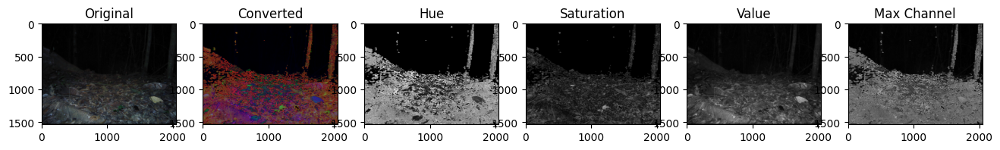

HLS


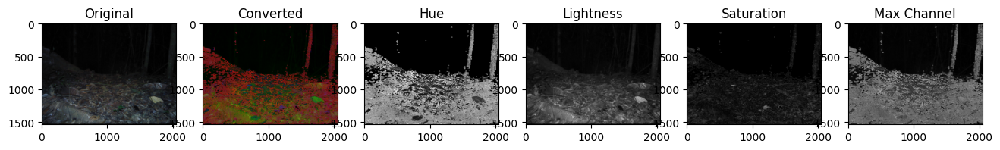

YUV


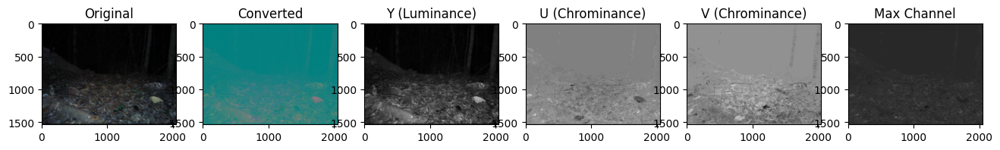

LUV


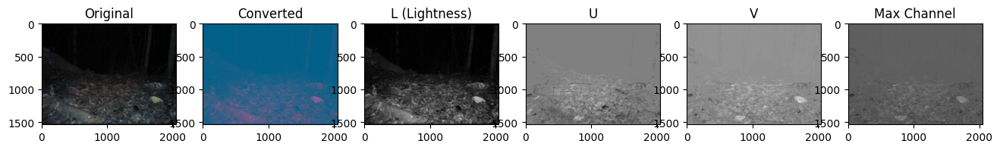

HSV


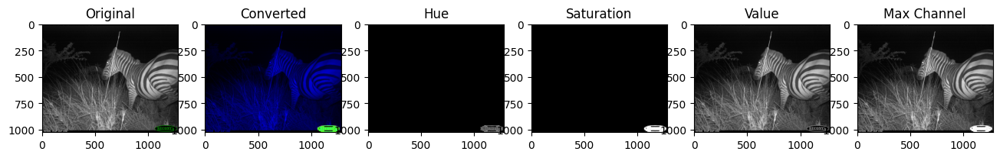

HLS


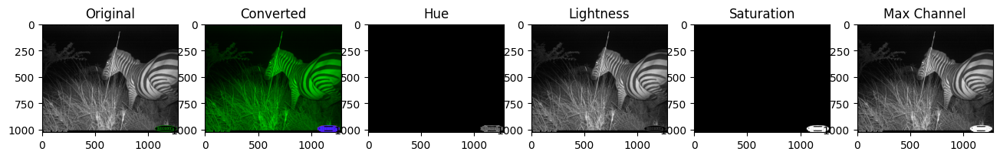

YUV


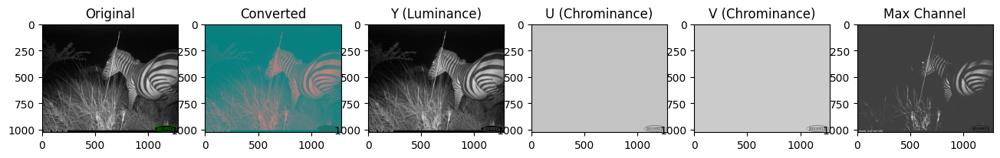

LUV


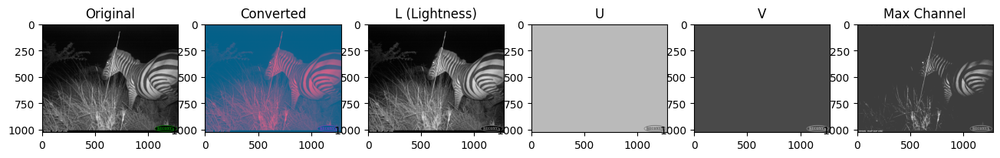

HSV


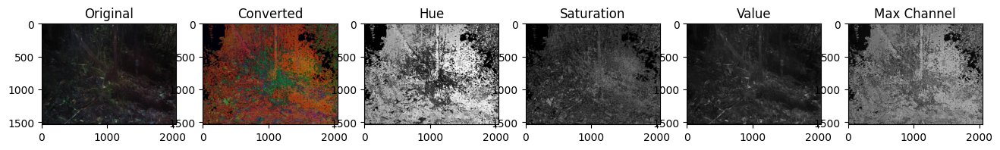

HLS


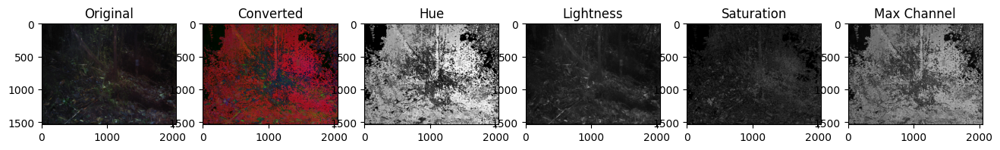

YUV


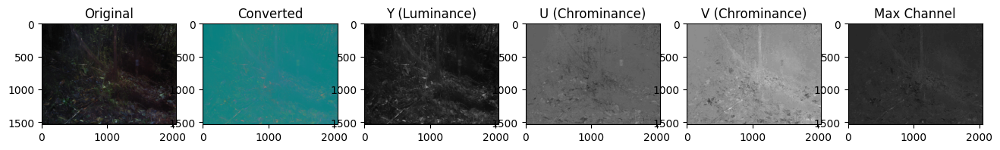

LUV


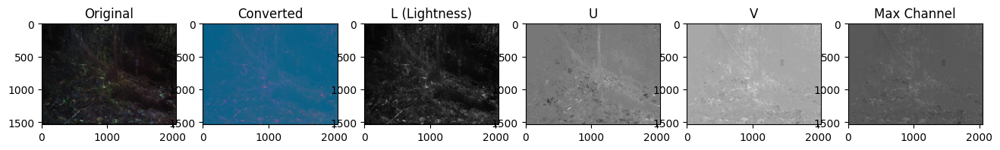

HSV


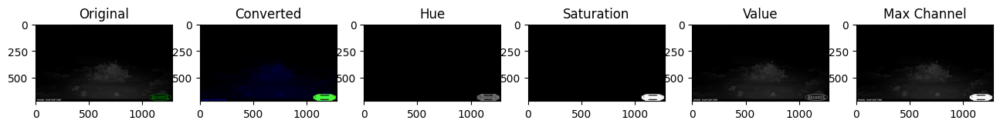

HLS


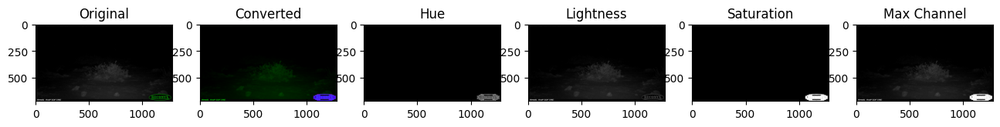

YUV


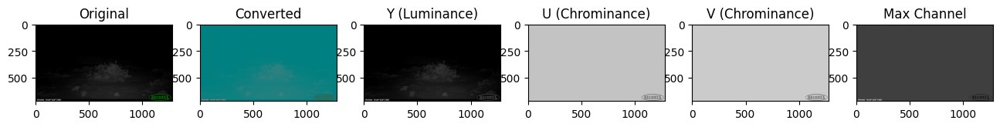

LUV


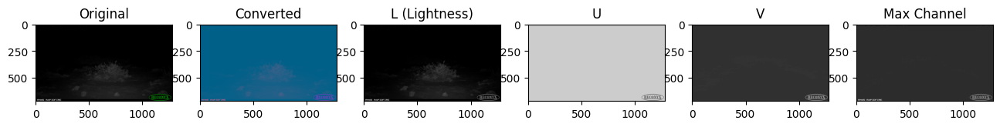

HSV


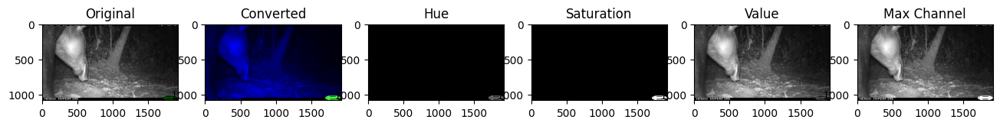

HLS


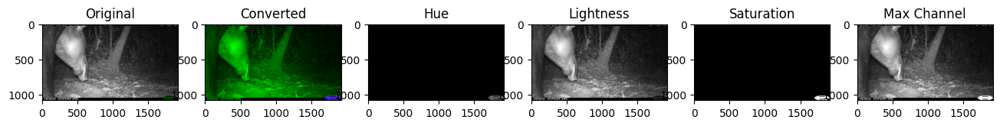

YUV


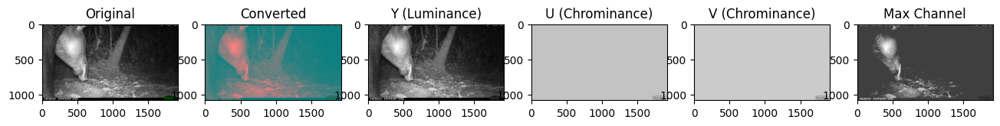

LUV


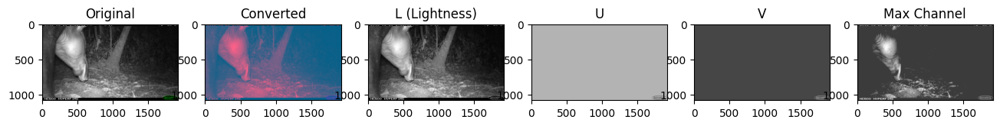

HSV


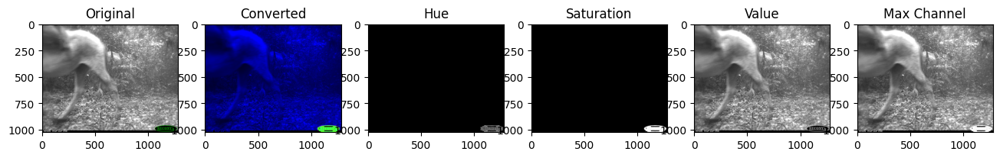

HLS


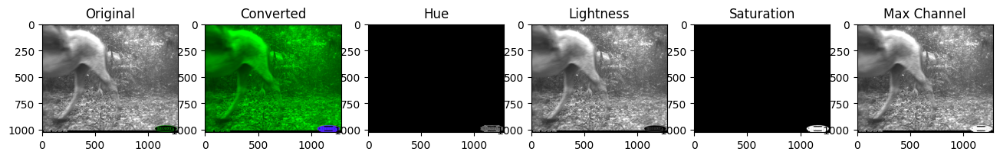

YUV


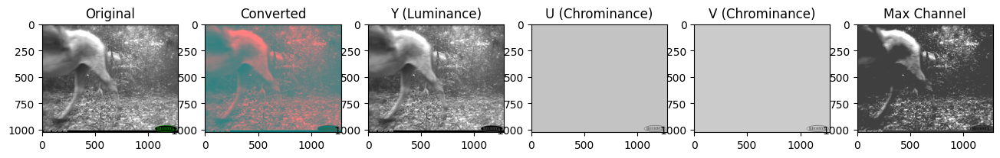

LUV


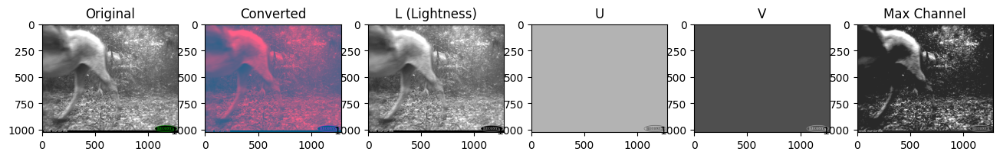

HSV


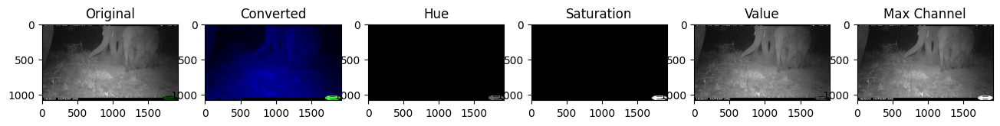

HLS


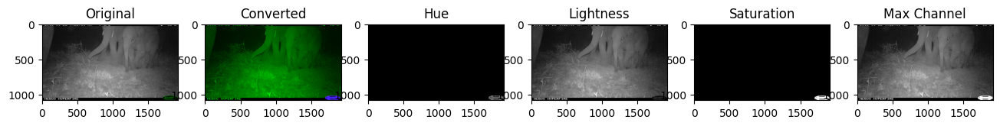

YUV


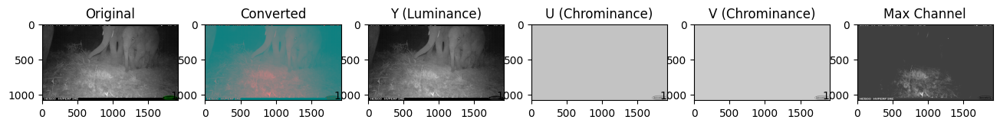

LUV


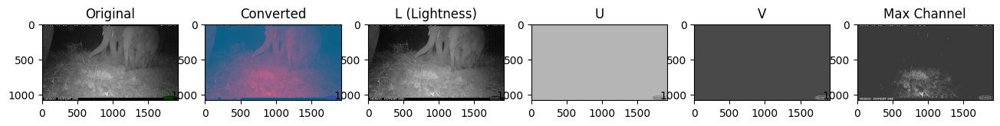

HSV


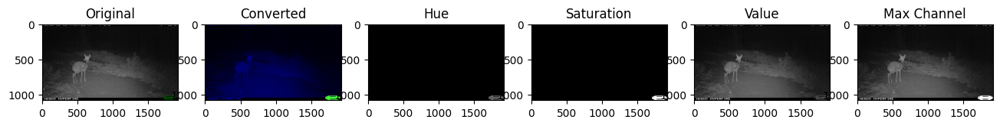

HLS


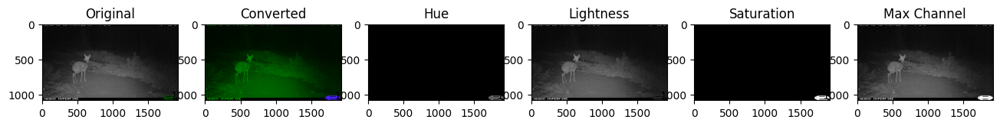

YUV


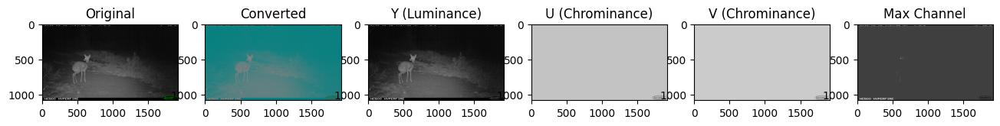

LUV


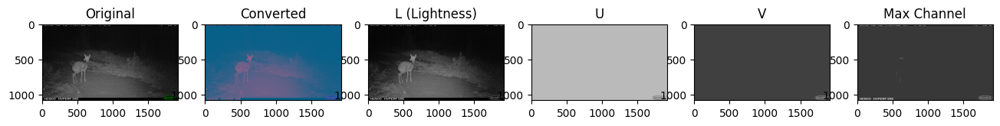

HSV


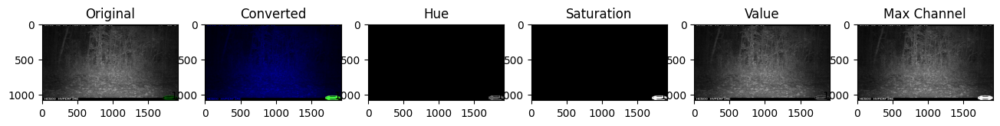

HLS


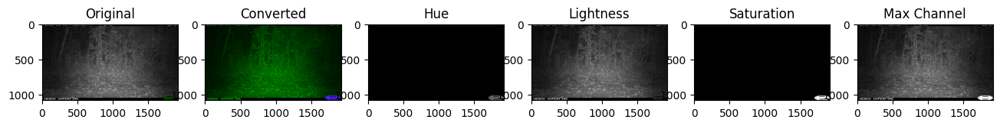

YUV


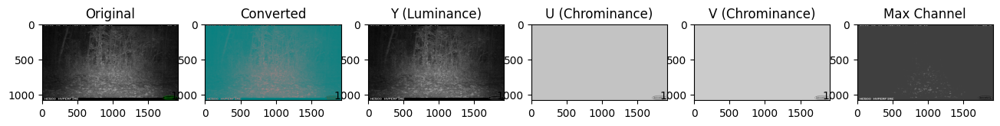

LUV


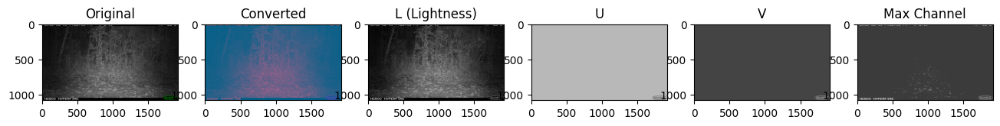

HSV


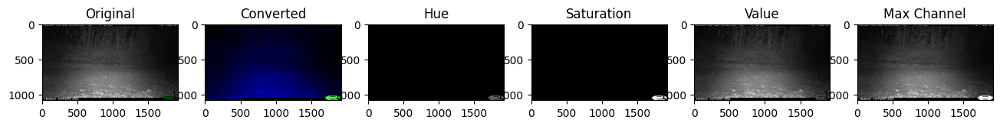

HLS


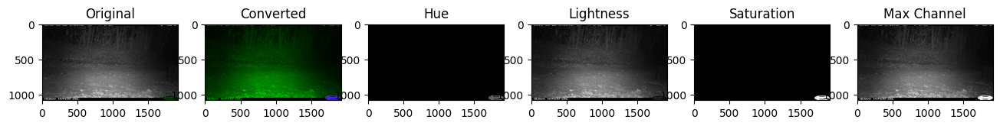

YUV


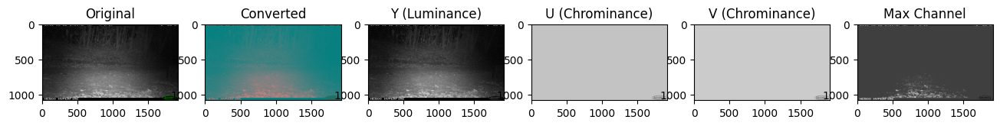

LUV


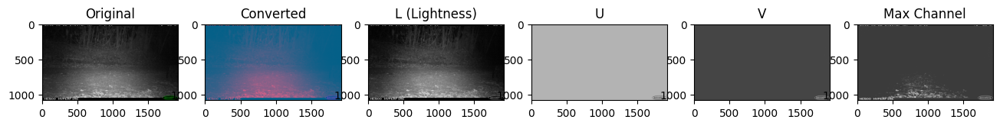

HSV


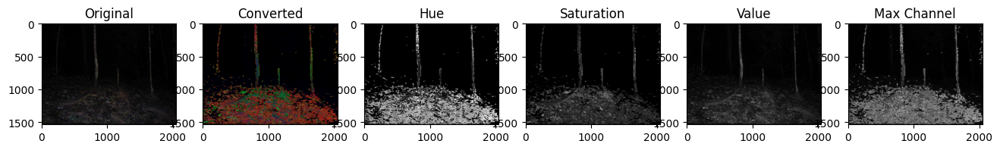

HLS


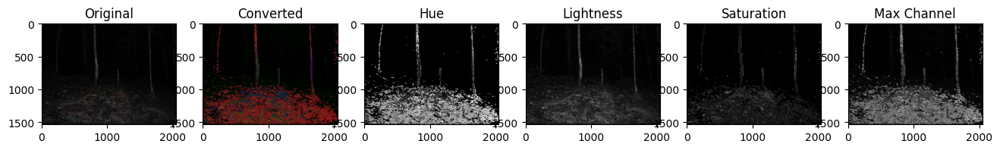

YUV


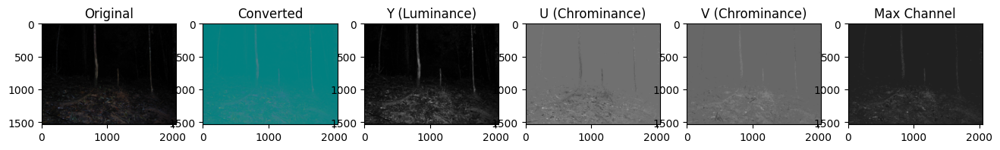

LUV


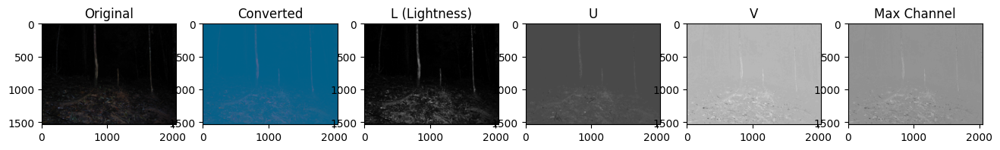

HSV


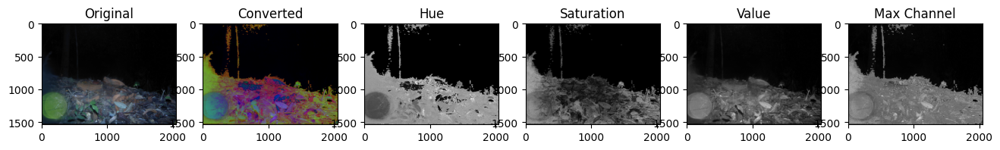

HLS


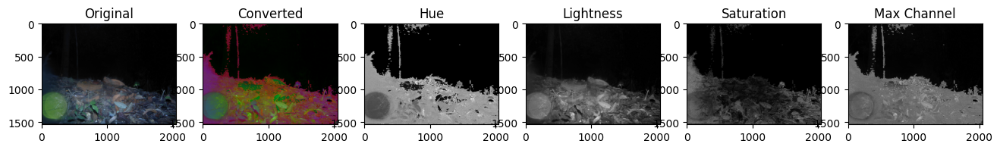

YUV


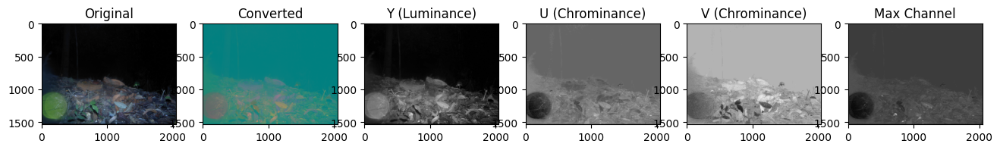

LUV


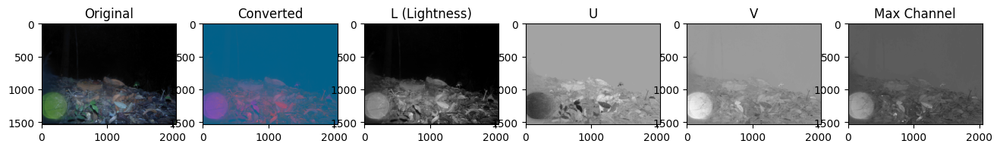

In [113]:
for image in darks_images:
    hsv_check(image)
    hls_check(image)
    yuv_check(image)
    luv_check(image)

In night time channels that correspondi to light contain more information, so simply using one channel instead all 3 of image representation is benefitial, so preferably will be used LUV image representation

### Method 2

Simple transforms by Histogram Equalization. Enhances image contrast by equalizing the Y (luminance) channel.

In [114]:
def yuv_eq(image):
    img = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
    img_eq = img.copy()
    img_eq[:, :, 0] = cv2.equalizeHist(img[:, :, 0])
    img_output = cv2.cvtColor(img_eq, cv2.COLOR_YUV2RGB)
    showInRow(
        [image, img, img_eq, img_output],
        titles=["Original", "Original YUV", "Equalized Y", "Output RGB"],
    )

In [115]:
def hls_eq(image):
    img_hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    img_eq = img_hls.copy()
    img_eq[:, :, 1] = cv2.equalizeHist(img_hls[:, :, 1])
    img_output = cv2.cvtColor(img_eq, cv2.COLOR_HLS2RGB)
    showInRow(
        [image, img_hls, img_eq, img_output],
        titles=["Original", "Original HLS", "Equalized L", "Output RGB"],
    )

In [116]:
def luv_eq(image):
    img_luv = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
    img_eq = img_luv.copy()
    img_eq[:, :, 0] = cv2.equalizeHist(img_luv[:, :, 0])
    img_output = cv2.cvtColor(img_eq, cv2.COLOR_LUV2RGB)
    showInRow(
        [image, img_luv, img_eq, img_output],
        titles=["Original", "Original LUV", "Equalized L", "Output RGB"],
    )

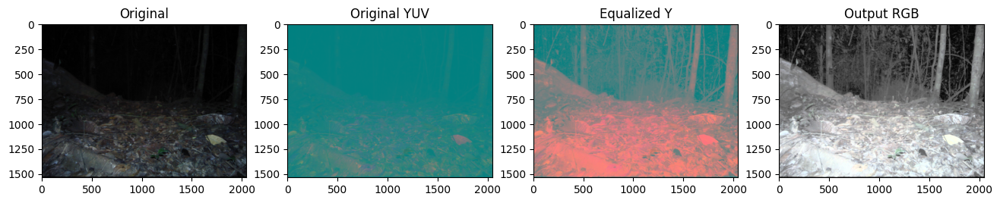

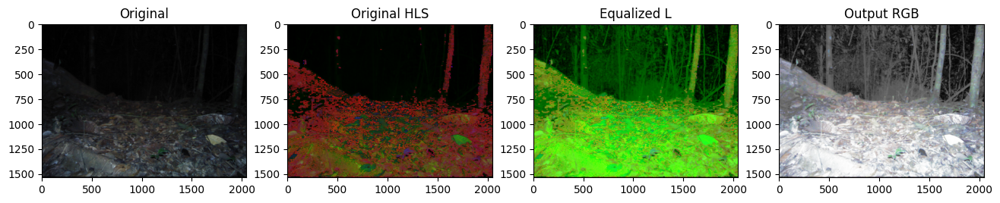

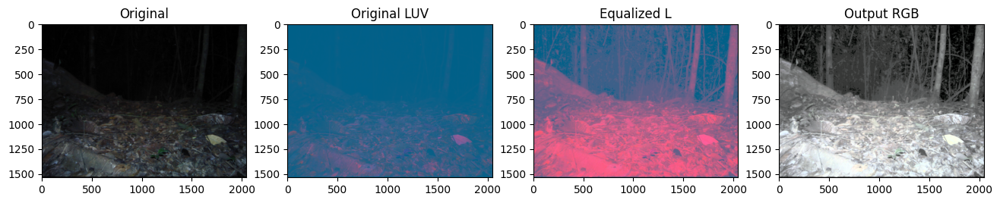

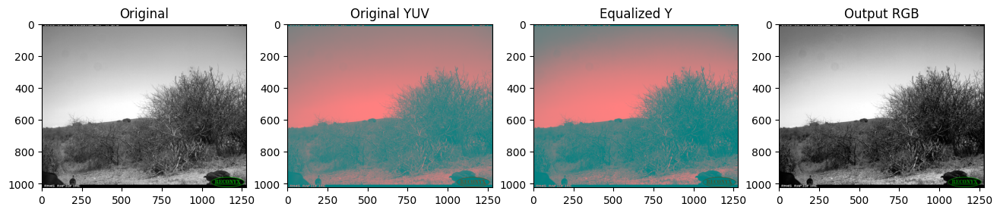

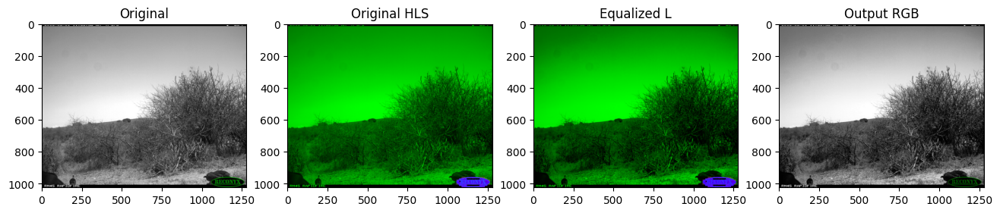

...

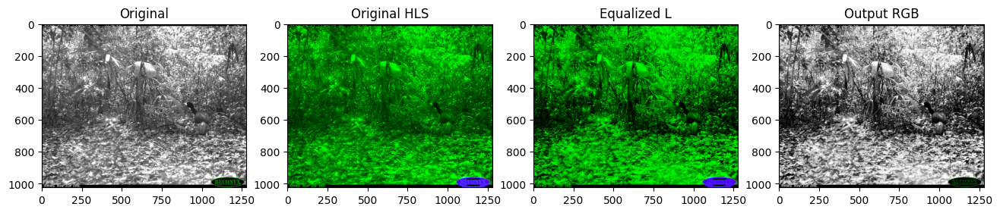

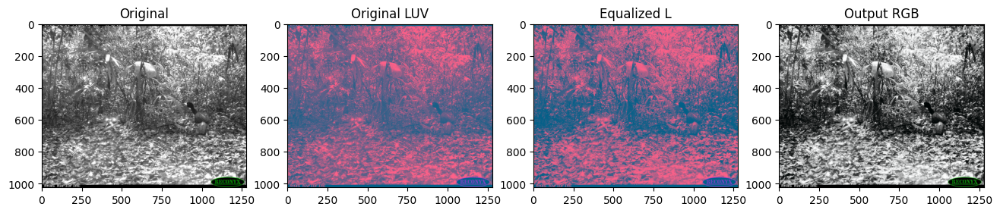

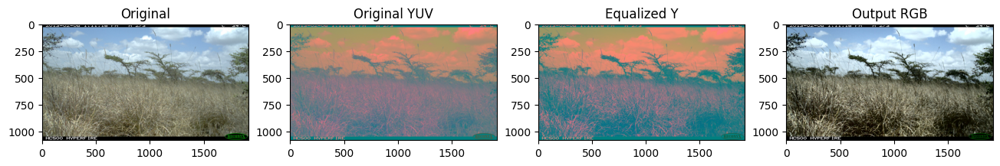

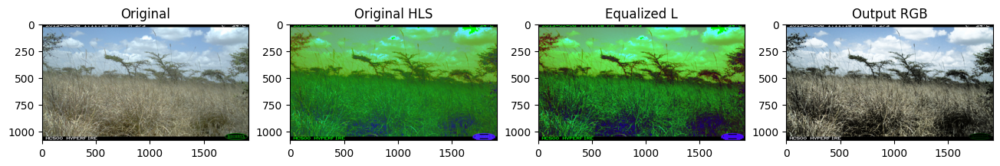

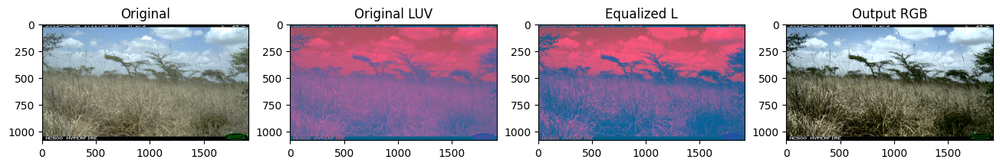

In [119]:
for image in [np.array(image) for i, image in enumerate(q[0]["image"][:10])]:
    yuv_eq(image)
    hls_eq(image)
    luv_eq(image)

### This simple method shows great result for night time images, but create some issues for day time ones (this could be predicted because of possible differences in light channel data and it's futher equlizing). Dataset labels contain time stemps, so this will not be an issue

### Method 3


Method from [this article](https://jivp-eurasipjournals.springeropen.com/articles/10.1186/s13640-018-0251-4) was checked [github of it's implemetnation](https://github.com/tranleanh/nighttime-image-enhancement)

Result of tesing (no cells in the notebook) this method did not get any reasonable effectiveness (due to need of parameter tuning, higher number of computaions)

#### For now following code is the one to preprocess the night-time images

In [ ]:
from typing import Any, Tuple

from cv2 import Mat
from numpy import dtype, floating, integer, ndarray


def preprocess_dark_images(
    image: np.ndarray, resize_dim: Tuple[int, int]
) -> Mat | ndarray[Any, dtype[integer[Any] | floating[Any]]]:
    img = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
    img_eq = img.copy()
    img_eq[:, :, 0] = cv2.equalizeHist(img[:, :, 0])
    final_img = cv2.cvtColor(img_eq, cv2.COLOR_LUV2RGB)
    if resize_dim is not None:
        final_img = cv2.resize(final_img, resize_dim, interpolation=cv2.INTER_AREA)
    return final_img